In [3]:
import pandas as pd


import numpy as np
import pandas as pd
import cv2 

import matplotlib.pyplot as plt

import os
import os.path
import random 
from skimage.color import rgb2gray

import numpy as np
import pandas as pd
import cv2 
import scipy

import matplotlib.pyplot as plt; plt.rcdefaults()
import numpy as np
import matplotlib.pyplot as plt

import os
import os.path
import random 

from math import sqrt
from skimage.feature import blob_dog, blob_log, blob_doh
from skimage.color import rgb2gray

In [24]:
def LOG(image): 
    #Reading image
    #image = cv2.imread(image)
    array = []
    image = rgb2gray(image)
    blobs_log = blob_log((image), max_sigma=3, num_sigma=2, threshold=.1)

    # Compute radii in the 3rd column.
    blobs_log[:, 2] = blobs_log[:, 2] * sqrt(2)

    #blobs_dog = blob_dog(image, max_sigma=30, threshold=.1)
    #blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

    #blobs_doh = blob_doh(image, max_sigma=30, threshold=.01)

    blobs_list = [blobs_log]
    colors = ['yellow']
    titles = ['Laplacian of Gaussian']
    sequence = zip(blobs_list, colors, titles)

    #fig, axes = plt.subplots(1, 3, figsize=(9, 3), sharex=True, sharey=True)
    #ax = axes.ravel()
    count = 0
    for idx, (blobs, color, title) in enumerate(sequence):
        #ax[idx].set_title(title)
        #ax[idx].imshow(image)
        for blob in blobs:
            #y, x, r = blob
            #c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
            #ax[idx].add_patch(c)
            count = count +1
        #array.append(count)
    #ax[idx].set_axis_off()
    
    return count

In [4]:
imagepath = "Images_Nano/"

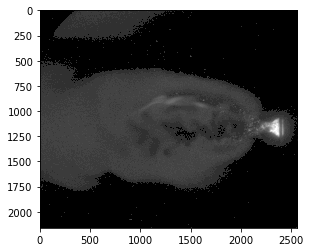

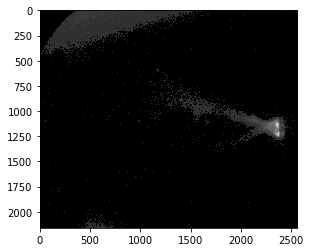

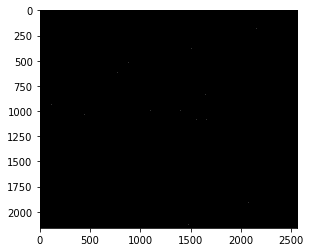

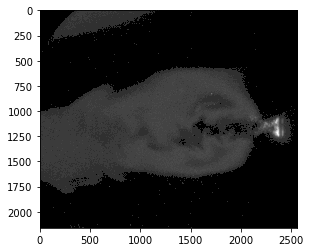

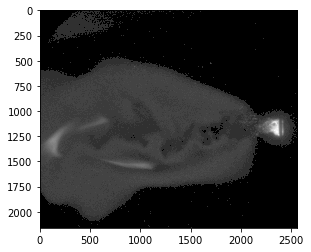

...

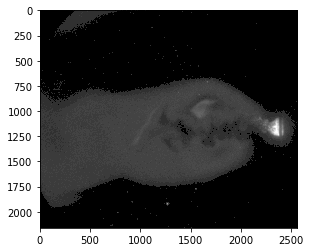

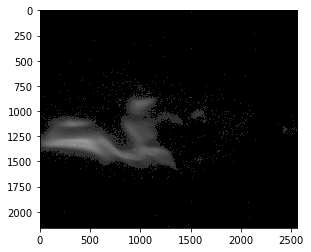

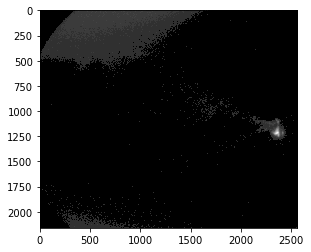

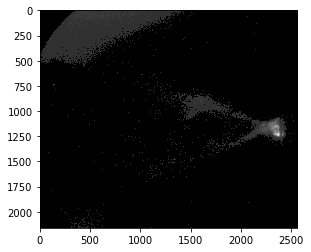

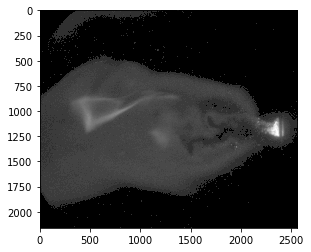

In [4]:
for filename in os.listdir(imagepath):
    image = imagepath+filename
    image = cv2.imread(image)
    plt.imshow(image)
    plt.show()

/anaconda2/envs/model1/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


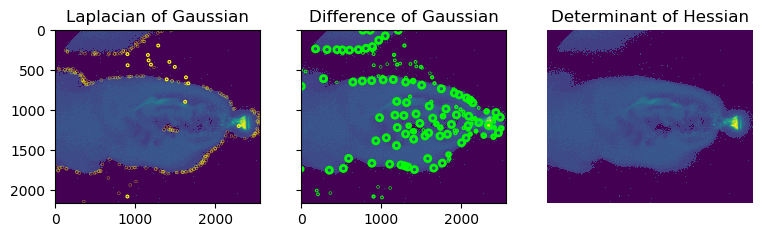

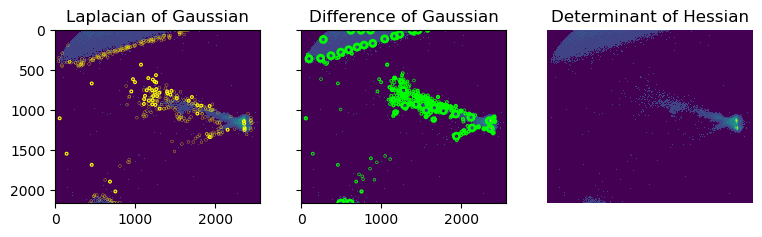

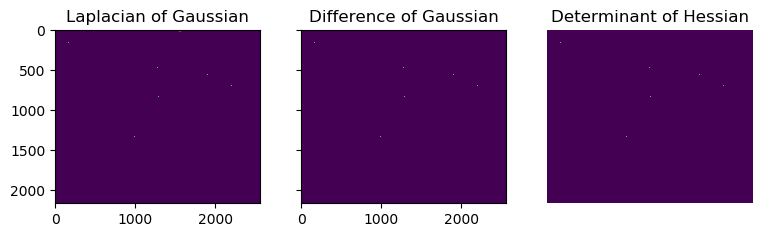

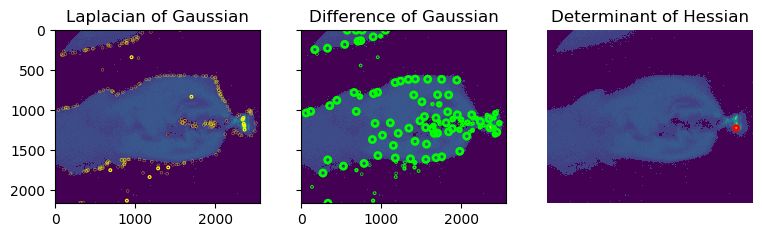

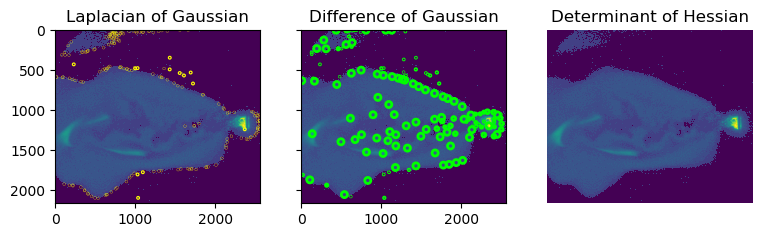

...

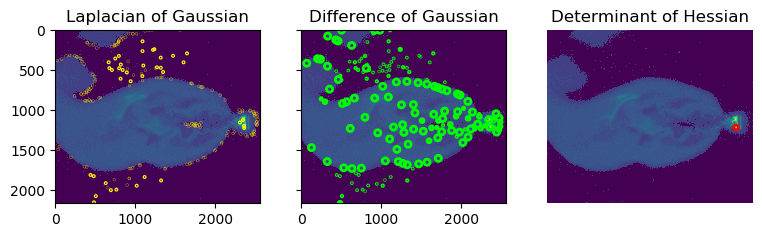

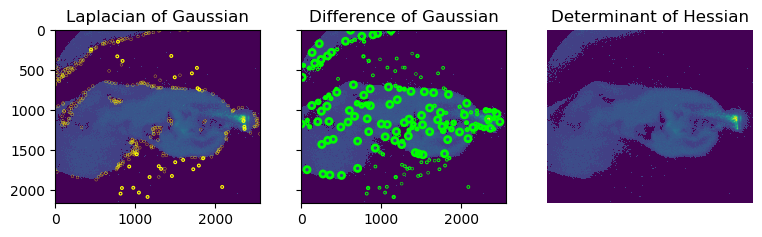

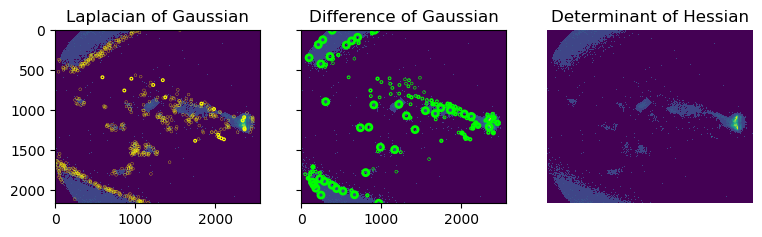

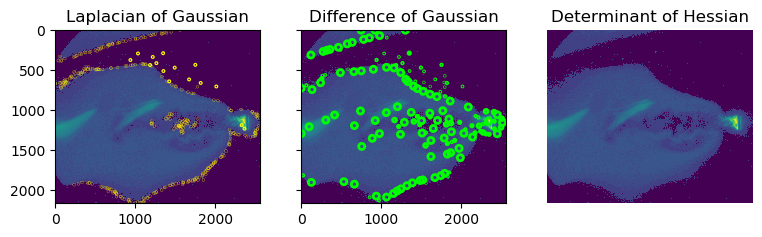

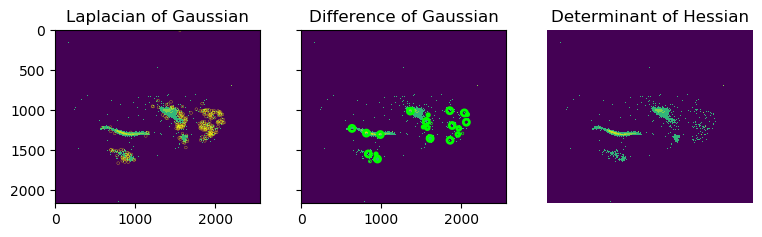

In [103]:
#WithCount
X = []
i = 0
for filename in os.listdir(imagepath):
    if i == 150:
        break
    image = imagepath+filename
    image = cv2.imread(image)
    X.append(LOG(image))
    i = i+1

In [109]:
X

[[249, 142, 0],
 [372, 248, 0],
 [1, 0, 0],
 [231, 118, 1],
 [200, 134, 0],
 [335, 115, 0],
 [1, 0, 0],
 [234, 46, 0],
 [380, 173, 0],
 [674, 313, 1],
 [263, 189, 0],
 [160, 17, 0],
 [499, 305, 0],
 [390, 145, 0],
 [239, 145, 0],
 [488, 172, 2],
 [312, 130, 0],
 [260, 74, 0],
 [217, 170, 0],
 [313, 137, 0],
 [12, 2, 0],
 [261, 161, 0],
 [354, 144, 0],
 [55, 7, 0],
 [434, 183, 1],
 [252, 132, 0],
 [264, 119, 0],
 [150, 18, 0],
 [297, 179, 0],
 [448, 160, 1],
 [439, 153, 1],
 [448, 142, 1],
 [3, 0, 0],
 [237, 141, 0],
 [378, 144, 2],
 [417, 160, 0],
 [1, 0, 0],
 [551, 292, 0],
 [433, 154, 0],
 [214, 141, 1],
 [316, 140, 1],
 [582, 188, 1],
 [333, 187, 1],
 [45, 6, 0],
 [621, 203, 1],
 [67, 13, 0],
 [385, 165, 1],
 [157, 120, 0],
 [518, 187, 0],
 [272, 142, 0],
 [366, 183, 2],
 [341, 155, 1],
 [2, 0, 0],
 [181, 133, 0],
 [266, 164, 1],
 [772, 363, 1],
 [270, 171, 0],
 [461, 119, 0],
 [361, 185, 0],
 [436, 186, 0],
 [680, 404, 0],
 [181, 108, 0],
 [370, 189, 0],
 [378, 153, 0],
 [853, 396,

# PCA

In [106]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [167]:
labels_fin = []
for i in X:
    if (i[0]<10 or i[0] > 450):
        labels_fin.append("Spill")
    else:
        labels_fin.append("No Spill")

In [168]:
df = pd.DataFrame(columns = ['B1', 'B2', 'B3', 'Type'])
i = 0
for arr in X:
    df = df.append({'B1': arr[0], 'B2': arr[1], 'B3': arr[2], 'Type': labels_fin[i]}, ignore_index=True)
    i = i + 1

In [169]:
df

,B1,B2,B3,Type
0,249,142,0,No Spill
1,372,248,0,No Spill
2,1,0,0,Spill
3,231,118,1,No Spill
4,200,134,0,No Spill
5,335,115,0,No Spill
6,1,0,0,Spill
7,234,46,0,No Spill
8,380,173,0,No Spill
9,674,313,1,Spill


In [170]:
features = ['B1', 'B2']
# Separating out the features
x = df.loc[:, features].values
# Separating out the target
y = df.loc[:,['Type']].values
# Standardizing the features
x = StandardScaler().fit_transform(x)  

/anaconda2/envs/model1/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/anaconda2/envs/model1/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [171]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [172]:
finalDf = pd.concat([principalDf, df[['Type']]], axis = 1)

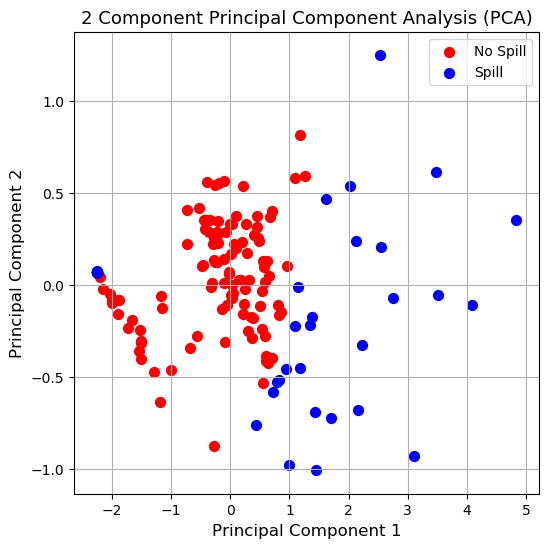

In [173]:
fig = plt.figure(figsize = (6,6))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 12)
ax.set_ylabel('Principal Component 2', fontsize = 12)
ax.set_title('2 Component Principal Component Analysis (PCA)', fontsize = 13)
targets = ['No Spill', 'Spill']
colors = ['r', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['Type'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [ ]:
import os

In [36]:
training = []
labels = []

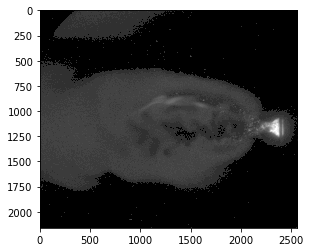

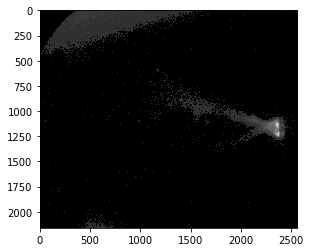

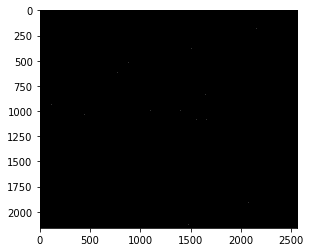

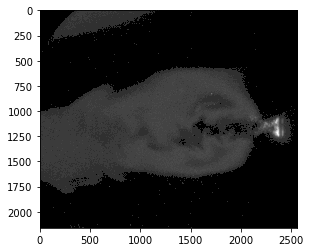

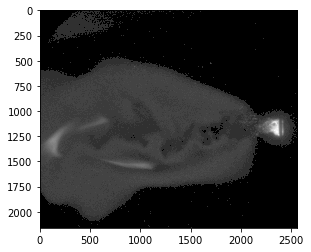

...

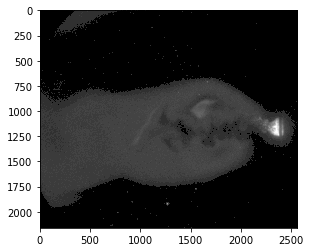

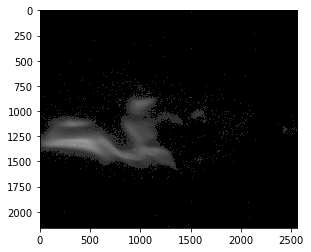

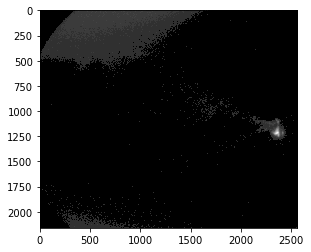

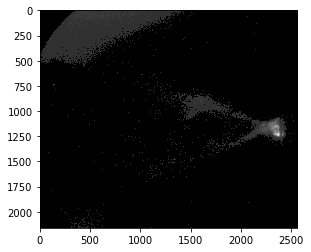

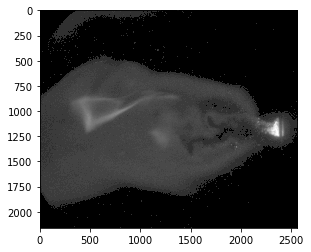

In [12]:
for filename in os.listdir(imagepath):
    image = imagepath+filename
    image = cv2.imread(image)
    plt.imshow(image)
    plt.show()
for filename in os.listdir(imagepath):
    image = imagepath+filename
    image = cv2.imread(image)
    image = image[1125:1300, 1700:2000]
    plt.imshow(image)
    plt.show()

In [37]:
for filename in os.listdir(imagepath):
    x = []
    image = imagepath+filename
    print(image)
    image = cv2.imread(image)
    s1 = LOG(image[250:600, 1000:2000])
    s2 = LOG(image[1000:1250, 2250:2500])
    s3 = LOG(image[1900:2000, 1000:2000])
    s4 = LOG(image[1125:1300, 1700:2000])
    avg = (s1+s2+s3+s4)/4
    training.append(avg)

Images_Nano/70Xy30AcN-3-6-25_OH000362.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000376.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000314.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000348.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000373.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000367.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000305.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000311.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000359.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000353.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000347.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000325.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000390.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000331.T000.D000.P000.H000

Images_Nano/70Xy30AcN-2-6-25_OH000324.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000346.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000369.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000394.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000335.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000357.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000301.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000363.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000349.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000310.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000372.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000358.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000344.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000350.T000.D000.P000.H000.PLIF

Images_Nano/70Xy30AcN-2-6-25_OH000369.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000352.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000346.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000324.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000391.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000330.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000385.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000378.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000400.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000372.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000366.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000304.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000310.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000363.T000.D000.P000.H000.

In [38]:
training

[4.75,
 4.75,
 0.0,
 12.25,
 5.5,
 1.0,
 0.0,
 8.5,
 8.25,
 25.25,
 8.0,
 0.5,
 10.25,
 15.75,
 8.75,
 10.0,
 15.0,
 1.25,
 6.75,
 6.75,
 0.0,
 17.75,
 5.5,
 0.25,
 7.25,
 5.75,
 4.5,
 5.75,
 8.75,
 19.5,
 8.75,
 8.75,
 0.0,
 6.25,
 11.25,
 10.0,
 0.0,
 18.25,
 7.75,
 5.0,
 14.25,
 8.25,
 9.5,
 0.5,
 14.0,
 0.0,
 11.25,
 5.75,
 7.75,
 8.5,
 3.5,
 1.75,
 0.0,
 7.0,
 7.5,
 23.25,
 5.25,
 16.75,
 7.75,
 7.25,
 15.5,
 3.0,
 8.75,
 10.25,
 25.75,
 4.75,
 10.25,
 0.25,
 7.5,
 8.0,
 2.5,
 13.25,
 0.25,
 0.0,
 4.75,
 4.25,
 0.0,
 2.75,
 27.25,
 11.5,
 7.0,
 11.5,
 0.0,
 2.75,
 7.5,
 13.75,
 6.25,
 6.5,
 10.0,
 0.0,
 12.25,
 29.0,
 17.0,
 1.0,
 16.0,
 14.5,
 18.75,
 10.0,
 5.25,
 0.5,
 10.0,
 6.0,
 17.75,
 3.75,
 4.25,
 8.0,
 6.5,
 5.75,
 0.0,
 5.25,
 12.0,
 8.0,
 0.0,
 5.5,
 22.5,
 3.0,
 9.75,
 4.25,
 14.25,
 13.25,
 14.0,
 1.75,
 10.25,
 5.5,
 3.75,
 3.5,
 4.75,
 7.25,
 8.5,
 18.75,
 4.75,
 7.5,
 4.0,
 2.0,
 16.0,
 6.5,
 0.0,
 7.5,
 6.0,
 12.5,
 11.75,
 2.75,
 2.75,
 2.75,
 0.0,
 12.5,
 4.75,

In [49]:
xaxis = []
for item in training:
    xaxis.append(random.uniform(1,2))

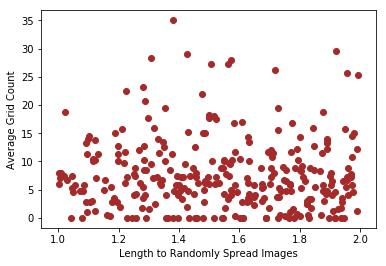

In [55]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

plt.scatter(xaxis, training, color='brown')
plt.xlabel('Length to Randomly Spread Images')
plt.ylabel('Average Grid Count')
#plt.title(label='Laplacian Blob Detection Count for SEM Images')
#brown_patch = mpatches.Patch(color='brown', label='Blurry Images')
#blue_patch =mpatches.Patch(color='lightblue', label='Focused Images')
#plt.axhline(y=350, color='green', linestyle='-', linewidth = 3.5)
#plt.axhline(y=500, color='grey', linestyle='-')
#plt.axhline(y=200, color='grey', linestyle='-')
#plt.legend(handles=[brown_patch, blue_patch])

plt.show()

In [28]:
labels = []
for filename in os.listdir(imagepath):
    x = []
    image = imagepath+filename
    print(image)
    image = cv2.imread(image)
    num = LOG(image)
    if (num<10 or num > 450):
        labels.append("Spill!")
    else: 
        labels.append("No Spill!")

Images_Nano/70Xy30AcN-3-6-25_OH000362.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000376.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000314.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000348.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000373.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000367.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000305.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000311.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000359.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000353.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000347.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000325.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000390.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000331.T000.D000.P000.H000

Images_Nano/70Xy30AcN-2-6-25_OH000385.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000324.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000346.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000369.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000394.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000335.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000357.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000301.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000363.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000349.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000310.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000372.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000358.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000344.T000.D000.P000.H000.PLIF1

Images_Nano/70Xy30AcN-2-10-25_OH000394.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000321.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000369.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000352.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000346.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000324.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000391.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000330.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000385.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-6-25_OH000378.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000400.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-2-10-25_OH000372.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000366.T000.D000.P000.H000.PLIF1.TIF.TIF
Images_Nano/70Xy30AcN-3-6-25_OH000304.T000.D000.P000.H000.P

In [34]:
rf_df = pd.DataFrame(columns = ['B1', 'B2', 'B3', 'B4', 'Type'])
i = 0
for arr in training:
    rf_df = rf_df.append({'B1': arr[0], 'B2': arr[1], 'B3': arr[2], 'B4': arr[3], 'Type': labels[i]}, ignore_index=True)
    i = i + 1

In [30]:
X = training
y = labels

In [32]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [33]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

ValueError: setting an array element with a sequence.

# K-Means Clustering

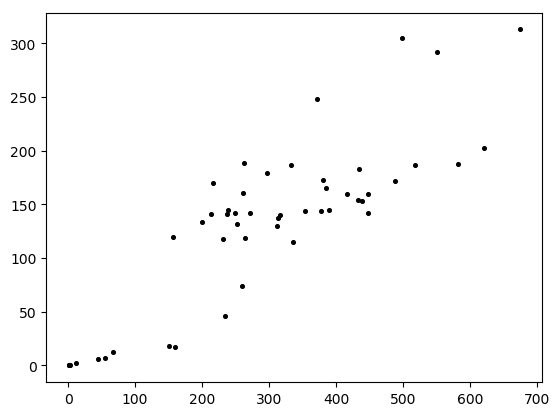

In [102]:
# Getting the values and plotting it
f1 = df['B1'].values
f2 = df['B2'].values
X = np.array(list(zip(f1, f2)))
plt.scatter(f1, f2, c='black', s=7)

In [104]:
# Euclidean Distance Caculator
def dist(a, b, ax=1):
    return np.linalg.norm(a - b, axis=ax)

In [105]:
# Number of clusters
k = 2
# X coordinates of random centroids
C_x = np.random.randint(0, np.max(X)-20, size=k)
# Y coordinates of random centroids
C_y = np.random.randint(0, np.max(X)-20, size=k)
C = np.array(list(zip(C_x, C_y)), dtype=np.float32)
print(C)

[[554. 240.]
 [394. 842.]]


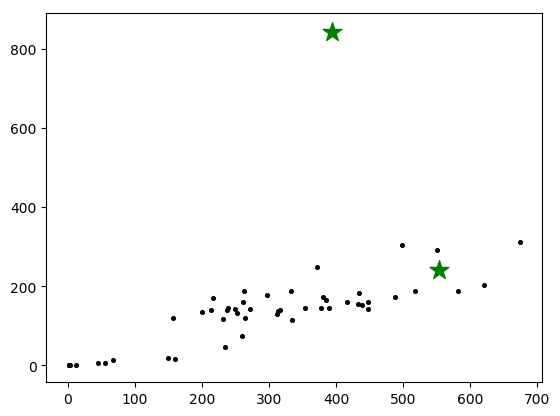

In [174]:
# Plotting along with the Centroids
plt.scatter(f1, f2, c='#050505', s=7)
plt.scatter(C_x, C_y, marker='*', s=200, c='g')